Provide Valid Facebook Cookies:
If you need to scrape non-public profiles, you'll need to provide valid Facebook cookies. Here's how you can do that:

a. Log in to your Facebook account in a web browser.

b. After logging in, open the browser's developer tools (usually by pressing F12 or right-clicking and selecting "Inspect").

c. Go to the "Network" or "Console" tab, and find the request to www.facebook.com.

d. In the request headers, look for the cookie field, and copy the entire cookie value.

e. Pass the cookie value to the facebook_scraper function using the cookies parameter:


In [9]:
from pyvis.network import Network
import networkx as nx
import pickle

# Load your graph
with open('state.pickle', 'rb') as file:
    state = pickle.load(file)
    friends_graph = state['graph']

limit = 10
# Iterate through all nodes and print their names
for node, data in friends_graph.nodes(data=True):
    print(node, data)
    limit -= 1
    if limit <= 0:
        break


Yitong {'user_id': '1685166343', 'name': 'Yitong Tseo', 'profile_pic': 'https://scontent-bos5-1.xx.fbcdn.net/v/t39.30808-6/271351549_10217798415027150_4315449223958310443_n.jpg?stp=cp0_dst-jpg_e15_fr_q65&_nc_cat=109&ccb=1-7&_nc_sid=5f2048&efg=eyJpIjoidCJ9&_nc_ohc=tikcmHgykREQ7kNvgH1Klp-&_nc_ht=scontent-bos5-1.xx&oh=00_AfB5k8UGaCNw8D1B-SVcjv1bdzGcNvIA94ciNR5pd6cjMQ&oe=663A0BF6&manual_redirect=1'}
Michael Paul Crossen {'user_id': '1104361796', 'name': 'Michael Paul Crossen', 'profile_pic': 'https://scontent-bos5-1.xx.fbcdn.net/v/t1.18169-9/10007411_10204429615956169_3146314577102066531_n.jpg?stp=cp0_dst-jpg_e15_fr_q65&_nc_cat=108&ccb=1-7&_nc_sid=5f2048&efg=eyJpIjoidCJ9&_nc_ohc=q3B-j2QFZOwQ7kNvgEegc8e&_nc_ht=scontent-bos5-1.xx&oh=00_AfDquPKEPYlmfhLRUqWEDoalb1_xHhQMemwFgS4ZzW25lA&oe=665BA018&manual_redirect=1'}
James Ko {'user_id': '100000093932510', 'name': 'James Ko', 'profile_pic': 'https://scontent-bos5-1.xx.fbcdn.net/v/t39.30808-6/328772315_861189494966422_4807778577958488767_n.jpg?st

In [10]:
your_node = 'Yitong'

if your_node in friends_graph:
    friends_graph.remove_node(your_node)
    print(f"Node '{your_node}' removed successfully.")
else:
    print(f"Node '{your_node}' not found in the graph.")


Node 'Yitong' removed successfully.


In [11]:
from PIL import Image

# Function to create a simple placeholder image
def create_placeholder_image(width, height, color=(0, 0, 0)):
    return Image.new("RGB", (width, height), color)


In [12]:
# import networkx as nx
# import matplotlib.pyplot as plt
# import requests
# from io import BytesIO
# from PIL import Image
# import os

# # Draw the graph
# pos = nx.spring_layout(friends_graph)
# plt.figure(figsize=(12, 8))
# nx.draw(friends_graph, pos, node_color="lightgray", with_labels=False, node_size=500)
# num_errors = 0


# # Overlay profile pictures on nodes
# for node in friends_graph.nodes(data=True):
#     # Extract the relevant information
#     name = node[0]
#     profile_pic_url = node[1]["profile_pic"]
#     img_path = os.path.join('friend_pics', f"{name.replace(' ', '_')}.png")

#     if not os.path.exists(img_path):
#         img = create_placeholder_image(50, 50, color=(0, 0, 0))

#         # # Load the profile picture
#         # try:
#         #     response = requests.get(profile_pic_url)
#         #     img = Image.open(BytesIO(response.content))
#         #     # Scale the image to fit the node
#         #     print(f"Saving {name}'s picture!")
            
#         #     img.save(img_path)
#         # except:
#         #     num_errors += 1
#         #     img = create_placeholder_image(50, 50, color=(0, 0, 0))
#     else:
#         img = Image.open(img_path)


#     img.thumbnail((50, 50))

#     x, y = pos[name]
#     breakpoint()

#     # Convert graph coordinates to pixel coordinates (axes transformation)
#     ax = plt.gca()
#     x_pix, y_pix = ax.transData.transform((x, y))

#     # Create an inset axes for each profile picture
#     inset_ax = plt.axes(
#         [
#             x_pix / ax.figure.bbox.width - 0.025,
#             y_pix / ax.figure.bbox.height - 0.025,
#             0.05,
#             0.05,
#         ],
#         anchor="C",
#     )
#     inset_ax.imshow(img)
#     inset_ax.axis("off")

# # Save the figure
# plt.axis("off")
# plt.savefig("friends_network.png", bbox_inches="tight")
# plt.show()

# print(f"Couldn't load pictures for "+  num_errors + " friends")

In [13]:
# import networkx as nx
# import matplotlib.pyplot as plt
# import requests
# from io import BytesIO
# from PIL import Image
# import os

# # Draw the graph
# pos = nx.spring_layout(friends_graph)
# plt.figure(figsize=(12, 8))
# nx.draw(friends_graph, pos, node_color="lightgray", with_labels=False, node_size=500)
# num_errors = 0


# # Overlay profile pictures on nodes
# node = friends_graph.nodes(data=True)['Michael Paul Crossen']
# # Extract the relevant information
# name = 'Michael Paul Crossen'
# profile_pic_url = node["profile_pic"]
# img_path = os.path.join('friend_pics', f"{name.replace(' ', '_')}.png")

# if not os.path.exists(img_path):
#     img = create_placeholder_image(50, 50, color=(0, 0, 0))

# else:
#     img = Image.open(img_path)


# img.thumbnail((50, 50))

# x, y = pos[name]

# HOMEGROWN CELL SEGMENTATION

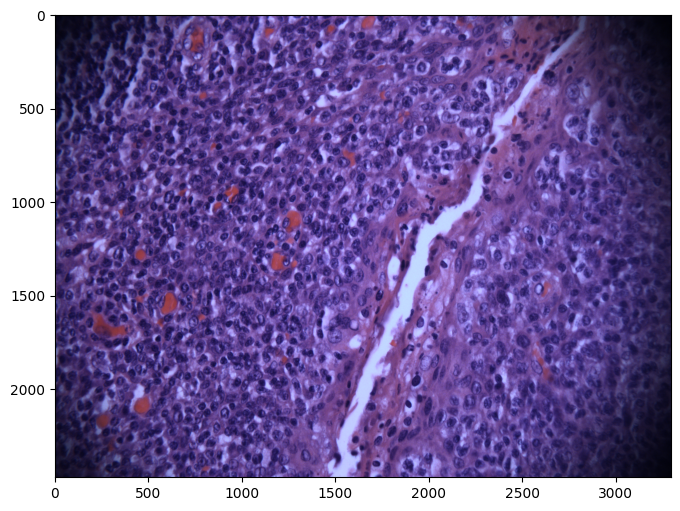

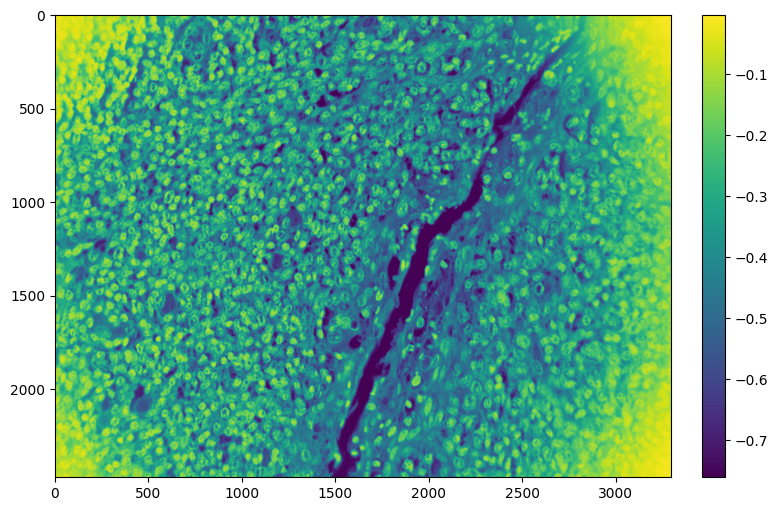

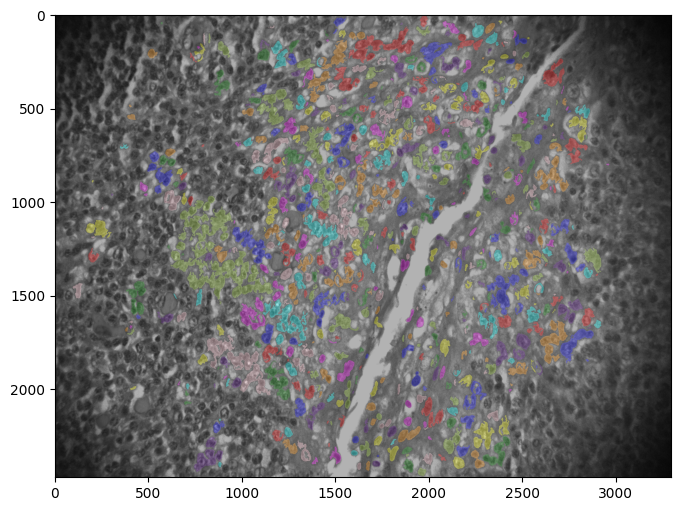

In [14]:
import numpy as np
from skimage import io, color, filters, measure, morphology
from skimage.segmentation import clear_border  # Correct import for clear_border

from skimage.transform import resize
from scipy.ndimage import center_of_mass
import matplotlib.pyplot as plt

def get_image_and_resize(filename, scale=1):
    image = io.imread(filename)
    image_shape = image.shape[:2]
    image_shape = tuple(ti // scale for ti in image_shape)
    return resize(image, image_shape, anti_aliasing=True), image_shape

def color_deconvolution(image, channel):
    # Assuming image is RGB, extract the channel of interest based on the typical staining
    # Here, 'channel' should be 0 for Hematoxylin (blue channel in H&E)
    return image[:, :, channel]

def segment_nuclei(image, channel=0, sigma=1.0, min_size=100, area_threshold=300, show_nuclei_channel=True):
    hematoxylin_channel = color_deconvolution(image, channel)
    hematoxylin_channel = -hematoxylin_channel
    if show_nuclei_channel:
        fig, ax = plt.subplots(figsize=(10, 6))
        im = ax.imshow(hematoxylin_channel)
        cbar = fig.colorbar(im, ax=ax, orientation='vertical', fraction=0.046, pad=0.04)
        # cbar.set_label('Intensity')  # You can customize the label as per your preference

        plt.show()
    val = filters.threshold_otsu(hematoxylin_channel)
    smoothed = filters.gaussian(hematoxylin_channel, sigma=sigma)
    binary = smoothed > val
    binary = morphology.remove_small_holes(binary, area_threshold=area_threshold)
    labeled = measure.label(binary)
    labeled = clear_border(labeled)
    labeled = morphology.remove_small_objects(labeled, min_size=min_size)
    return labeled

def process_image(filename):
    image, shape = get_image_and_resize(filename)
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.imshow(image)
    plt.show()

    labeled_nuclei = segment_nuclei(image)

    fig, ax = plt.subplots(figsize=(10, 6))
    ax.imshow(color.label2rgb(labeled_nuclei, bg_label=0, image=image))
    plt.show()

    return labeled_nuclei

# Use the function to process an image
filename = "/Users/yitongtseo/Documents/GitHub/ethical_necromancy/tonsil_city/tonsil_pics/yitong7.bmp"
labeled_nuclei = process_image(filename)


# USING OUT OF THE BOX SEGMENTATION

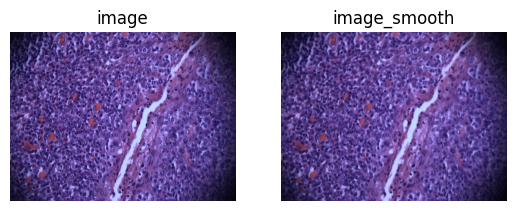

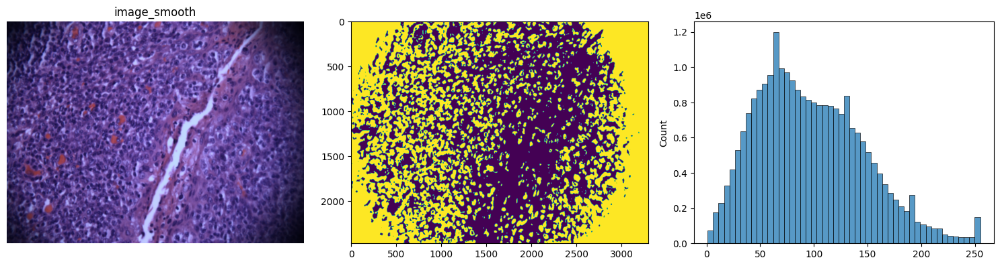

In [15]:
import numpy as np
from skimage import io
import matplotlib.pyplot as plt
import seaborn as sns

import squidpy as sq

filename = "/Users/yitongtseo/Documents/GitHub/ethical_necromancy/tonsil_city/tonsil_pics/yitong7.bmp"
img = io.imread(filename)
img = sq.im.ImageContainer(img, layer="image")

# load the H&E stained tissue image and crop to a smaller segment
# img = sq.datasets.visium_hne_image_crop()
# crop = img.crop_corner(0, 0, size=1000)

sq.im.process(img, layer="image", method="smooth", sigma=4)

# plot the result
fig, axes = plt.subplots(1, 2)
for layer, ax in zip(["image", "image_smooth"], axes):
    img.show(layer, ax=ax)
    ax.set_title(layer)

fig, axes = plt.subplots(1, 3, figsize=(15, 4))
img.show("image_smooth", cmap="gray", ax=axes[0])
axes[1].imshow(img["image_smooth"][:, :, 0, 0] < 90)
_ = sns.histplot(np.array(img["image_smooth"]).flatten(), bins=50, ax=axes[2])
plt.tight_layout()


/opt/anaconda3/envs/tonsil_city/lib/python3.9/site-packages/xarray/core/utils.py:494: FutureWarning:

The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.



ImageContainer[shape=(2472, 3296), layers=['image', 'image_smooth', 'segmented_watershed']]
Number of segments in crop: 5764


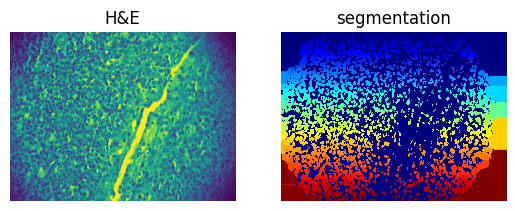

In [16]:
sq.im.segment(img=img, layer="image_smooth", method="watershed", thresh=90, geq=False)
print(img)
print(f"Number of segments in crop: {len(np.unique(img['segmented_watershed']))}")

fig, axes = plt.subplots(1, 2)
img.show("image", channel=0, ax=axes[0])
_ = axes[0].set_title("H&E")
img.show("segmented_watershed", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


# Tidy up (dedup overlapping cells, take out weird rectangles...)

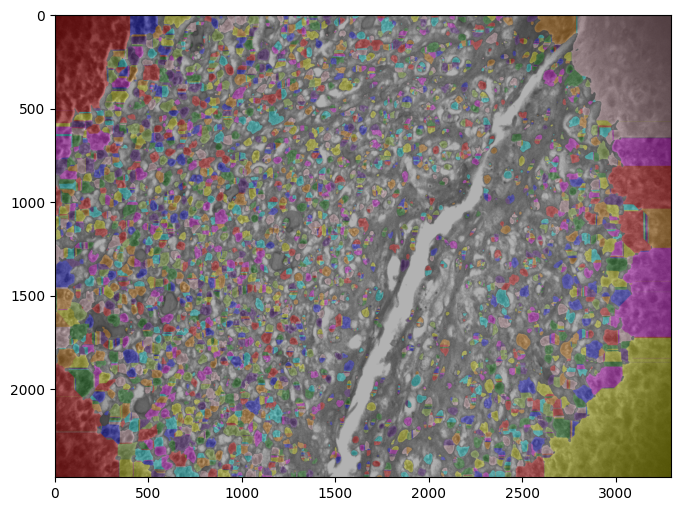

In [17]:
fig, ax = plt.subplots(figsize=(10, 6))
image, shape = get_image_and_resize(filename)

ax.imshow(color.label2rgb(img['segmented_watershed'].values.squeeze(), bg_label=0, image=image))
plt.show()


In [18]:
import numpy as np
from skimage.measure import regionprops, label
from scipy.spatial import KDTree

# Load your segmentation matrix
segmentation = img['segmented_watershed'].values.squeeze()

# Initial properties
props = regionprops(segmentation)
prop_data = [(prop.centroid, prop.area, prop.label, prop.axis_minor_length, prop.axis_major_length) for prop in props]

# KDTree for proximity queries
centroids, areas, labels, minor_lens, major_lens = zip(*prop_data)
tree = KDTree(np.array(centroids))

# Parameters
max_area = 10000
distance_threshold = 50

new_segmentation = np.zeros_like(segmentation)

for centroid, area, seg_label, minor_len, major_len in zip(centroids, areas, labels, minor_lens, major_lens):
    if area > max_area:
        continue  
    if minor_len == 0 or major_len == 0:
        continue

    indices = tree.query_ball_point(centroid, distance_threshold)
    combined_area = sum(areas[idx] for idx in indices)

    if combined_area <= max_area:
        weighted_centroid = np.average([centroids[idx] for idx in indices], axis=0, weights=[areas[idx] for idx in indices])
        new_label = min(labels[idx] for idx in indices)  # Use the smallest label for consistency
        for idx in indices:
            new_segmentation[segmentation == labels[idx]] = new_label
    else:
        new_segmentation[segmentation == seg_label] = seg_label

new_segmentation = label(new_segmentation)


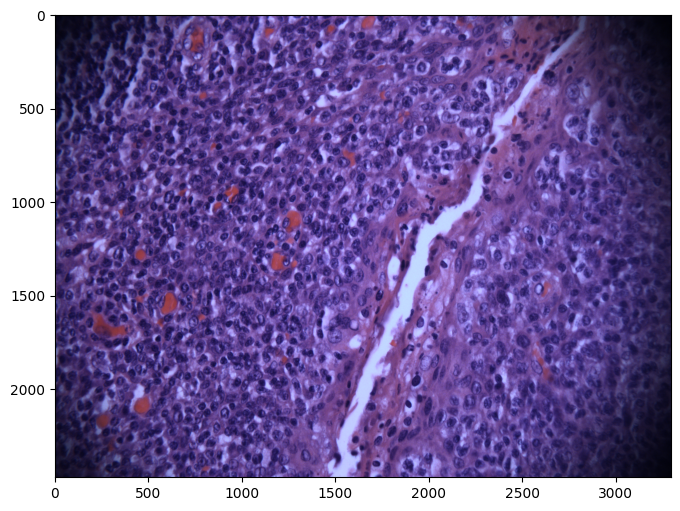

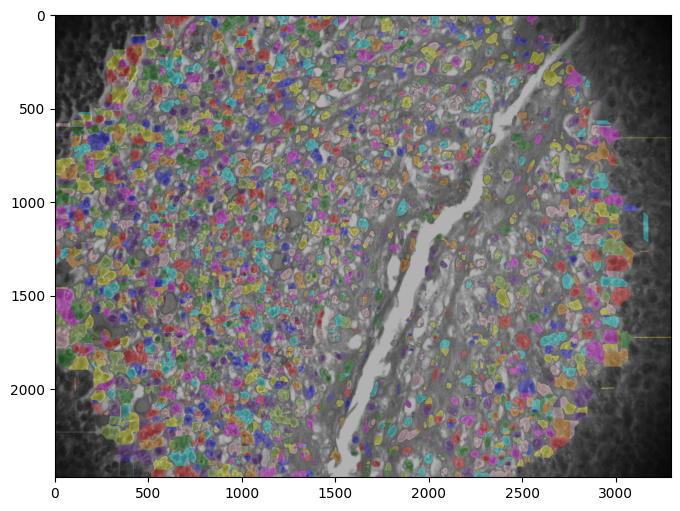

In [19]:
image, shape = get_image_and_resize(filename)
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(image)
plt.show()


fig, ax = plt.subplots(figsize=(10, 6))
image, shape = get_image_and_resize(filename)

ax.imshow(color.label2rgb(new_segmentation, bg_label=0, image=image))
plt.show()


# Let's make the cell graph!

In [20]:
props = regionprops(new_segmentation)
centroids = [prop.centroid for prop in props]

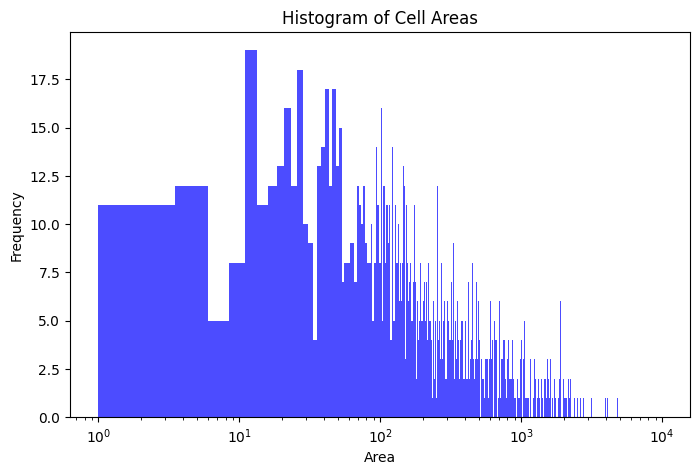

In [21]:
# Plot the pairwise distance matrix as a histogram
plt.figure(figsize=(8, 5))
plt.hist([prop.area for prop in props], bins=4000, color='blue', alpha=0.7)
plt.xlabel('Area')
plt.ylabel('Frequency')
plt.xscale('log')
plt.title('Histogram of Cell Areas')
plt.show()

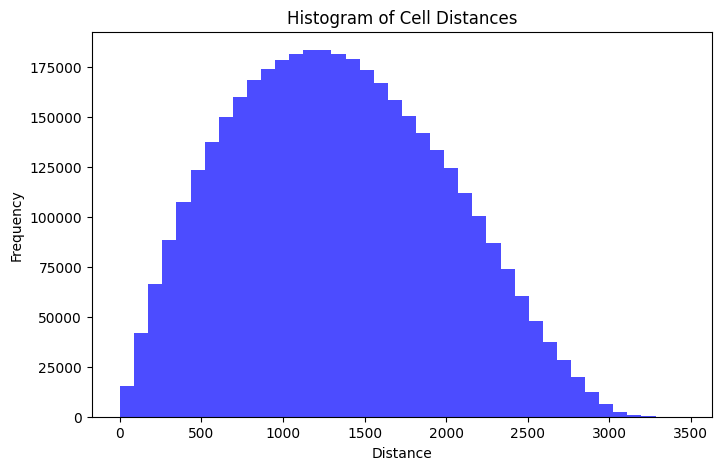

In [22]:
from scipy.spatial.distance import pdist

# Compute pairwise distances using Euclidean metric
pairwise_distances = pdist(centroids, metric='euclidean')


# Plot the pairwise distance matrix as a histogram
plt.figure(figsize=(8, 5))
plt.hist(pairwise_distances, bins=40, color='blue', alpha=0.7)
plt.xlabel('Distance')
plt.ylabel('Frequency')
plt.title('Histogram of Cell Distances')
plt.show()


In [23]:
# TODO: TUNE!
# TODO: maybe draw this from a gaussian graph each time? that way it allows long distance friends & introverts...
CUTOFF_MEAN = 100
CUTOFF_STD = 20



In [24]:
import networkx as nx
import numpy as np

# Create a graph
cell_graph = nx.Graph()

# Add nodes with position attributes
for idx, (x, y) in enumerate(centroids):
    cell_graph.add_node(idx, pos=(y, x))  # x, y for easier plotting later


# Add edges with distances
for i in range(len(centroids)):
    for j in range(i + 1, len(centroids)):
        dist = np.linalg.norm(np.array(centroids[i]) - np.array(centroids[j]))

        threshold = np.random.normal(loc=CUTOFF_MEAN, scale=CUTOFF_STD, size=None)

        if dist <= threshold:
            cell_graph.add_edge(i, j, weight=dist)


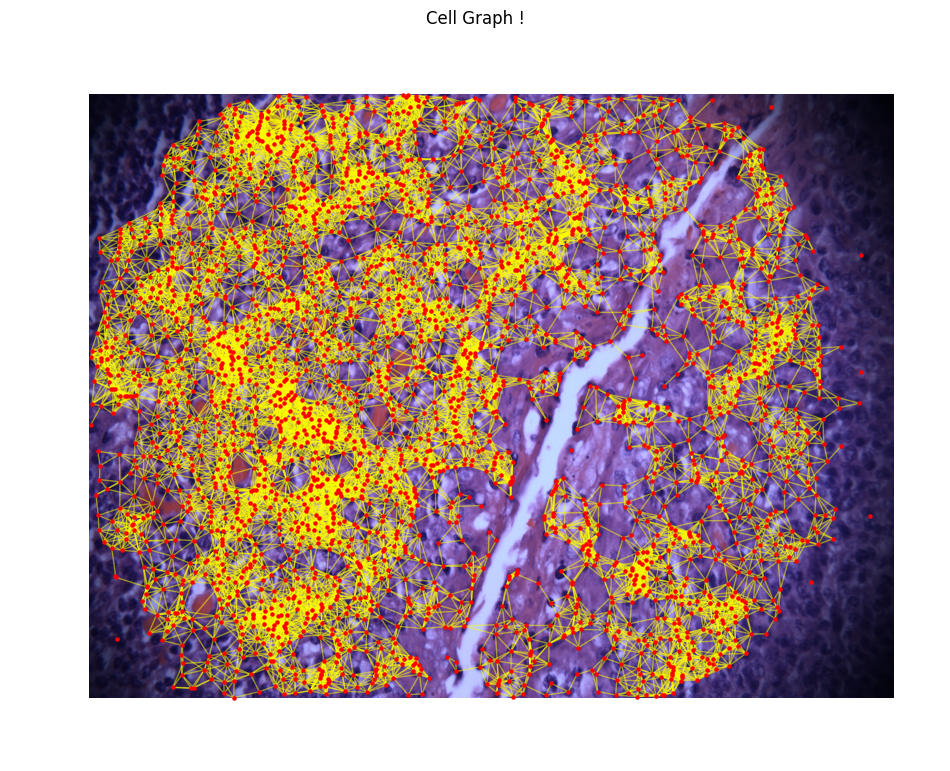

In [25]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
from skimage.io import imread

# Load your image (ensure the path and file are correct)
img = imread(filename)

pos = nx.get_node_attributes(cell_graph, 'pos')

fig, ax = plt.subplots(figsize=(12, 12))
ax.imshow(img) 
nx.draw_networkx_nodes(cell_graph, pos, ax=ax, node_size=5, node_color='red', alpha=1.0)
nx.draw_networkx_edges(cell_graph, pos, ax=ax, edge_color='yellow', alpha=0.5)

# Set plot details
ax.set_title('Cell Graph !')
ax.axis('off')  # Hide axes
plt.show()


In [26]:
len(centroids)

2815

# GRAPH EMBEDDING TIME!


In [27]:
import scipy
import gensim
print("SciPy version:", scipy.__version__)
print("Gensim version:", gensim.__version__)


SciPy version: 1.10.1
Gensim version: 4.3.2


In [38]:
%time

from node2vec import Node2Vec
SEED = 42

# Generate walks
# Shorter walk lens since the graph is really well connected... 
node2vec_cells = Node2Vec(cell_graph, dimensions=64, walk_length=5, num_walks=1000, workers=4, seed=SEED)
model_cells = node2vec_cells.fit(window=10, min_count=1, batch_words=4)
embeddings_cells = model_cells.wv
cell_embeddings = {node: embeddings_cells[node] for node in cell_graph.nodes()}



Computing transition probabilities:   3%|▎         | 98/2815 [00:00<00:02, 975.65it/s]

Generating walks (CPU: 4): 100%|██████████| 50/50 [00:01<00:00, 25.48it/s]


KeyboardInterrupt: 

In [ ]:
from sklearn.decomposition import PCA
import numpy as np
import pandas as pd

# Convert embeddings to array
embeddings_array = np.array(list(cell_embeddings.values()))

# Apply PCA to reduce to 2 dimensions
pca = PCA(n_components=2)
embeddings_2d = pca.fit_transform(embeddings_array)


# Extract original x and y coordinates from pos
x_coords = [pos[node][0] for node in cell_graph.nodes()]
y_coords = [pos[node][1] for node in cell_graph.nodes()]

# Create a DataFrame including PCA components and original coordinates
df = pd.DataFrame({
    'PCA1': embeddings_2d[:, 0],
    'PCA2': embeddings_2d[:, 1],
    'Original X': x_coords,
    'Original Y': y_coords
})


In [ ]:
import plotly.express as px
# Scatter plot colored by original X coordinate
fig_x = px.scatter(df, x='PCA1', y='PCA2', color='Original X', labels={'color': 'Original X Coordinate'},
                   title='PCA-Reduced Embeddings Colored by Original X Coordinate')
fig_x.show()


In [ ]:
# Scatter plot colored by original Y coordinate
fig_y = px.scatter(df, x='PCA1', y='PCA2', color='Original Y', labels={'color': 'Original Y Coordinate'},
                   title='PCA-Reduced Embeddings Colored by Original Y Coordinate')
fig_y.show()


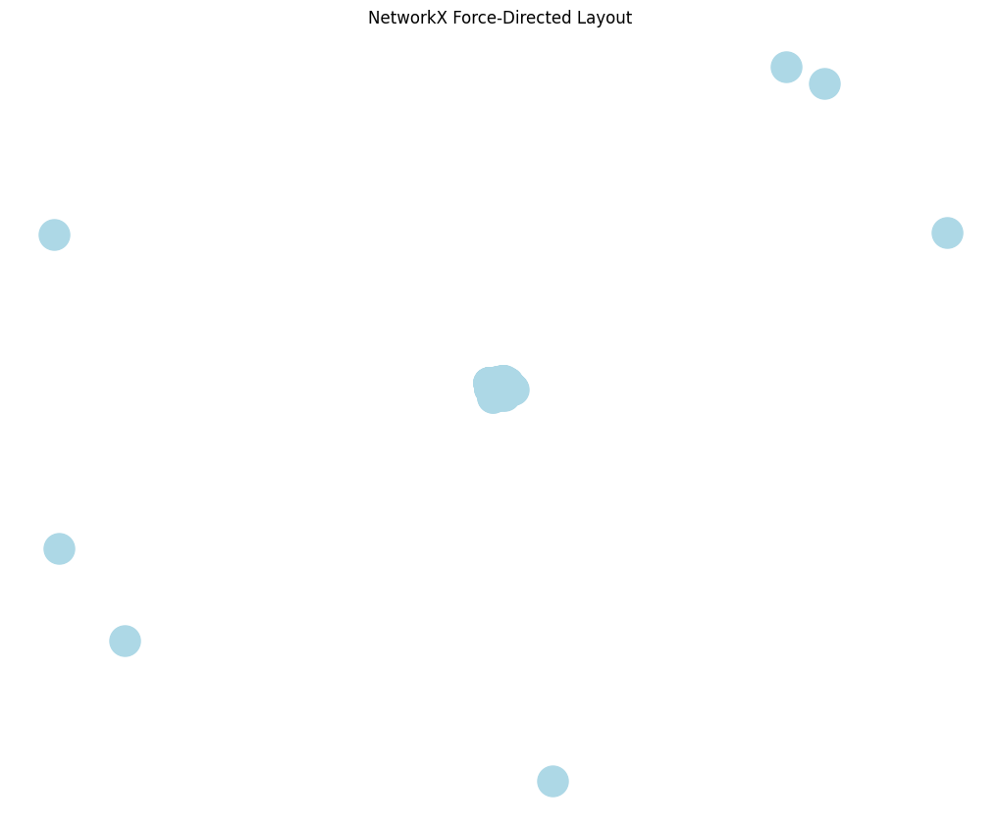

In [64]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

cell_pos = nx.spring_layout(
    cell_graph, dim=2, iterations=50, threshold=1e-2, k=1 / (10 * np.sqrt(3000)), 
)  # k can be adjusted for spacing

# Plot the graph
plt.figure(figsize=(10, 8))
nx.draw(
    cell_graph,
    pos,
    with_labels=False,#True,
    node_color="lightblue",
    edge_color="#909090",
    node_size=500,
)
plt.title("NetworkX Force-Directed Layout")
plt.show()

cell_pos = np.vstack([cell_pos[pos] for pos in cell_pos])

Friend embeddings

In [ ]:
from node2vec import Node2Vec
SEED = 42

node2vec_friends = Node2Vec(friends_graph, dimensions=64, walk_length=30, num_walks=200, workers=4, seed=SEED)
model_friends = node2vec_friends.fit(window=10, min_count=1, batch_words=4)
embeddings_friends = model_friends.wv
friend_embeddings = {node: embeddings_friends[node] for node in friends_graph.nodes()}

/opt/anaconda3/envs/tonsil_city/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Generating walks (CPU: 4): 100%|██████████| 50/50 [00:07<00:00,  7.01it/s]


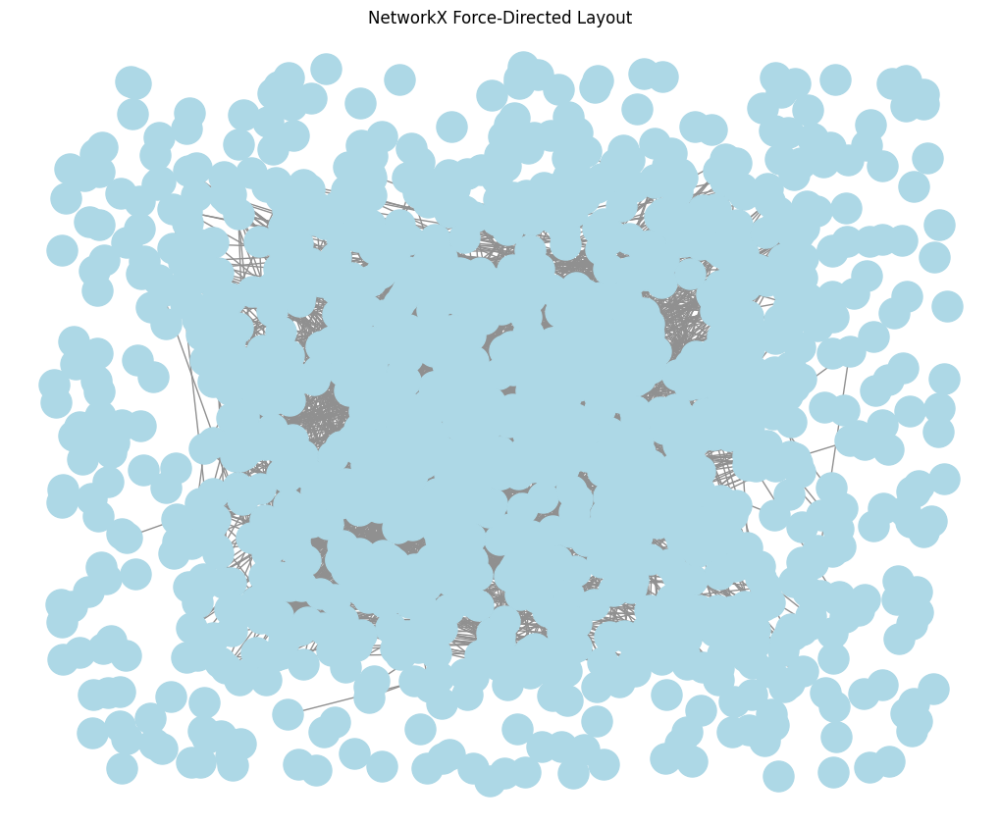

In [47]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

# Assuming you have a NetworkX graph already set up as `friends_graph`
pos = nx.spring_layout(
    friends_graph, dim=2, iterations=200, threshold=1e-2, k=1 / (10 * np.sqrt(1000)), 
)  # k can be adjusted for spacing

# Plot the graph
plt.figure(figsize=(10, 8))
nx.draw(
    friends_graph,
    pos,
    with_labels=False,#True,
    node_color="lightblue",
    edge_color="#909090",
    node_size=500,
)
plt.title("NetworkX Force-Directed Layout")
plt.show()



In [48]:
import plotly.graph_objects as go

# Create edge traces
edge_trace = []
for edge in friends_graph.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_trace.append(
        go.Scatter(
            x=[x0, x1, None],  # None is used to prevent lines from connecting to the next edge
            y=[y0, y1, None],
            mode='lines',
            line=dict(width=2, color='#888'),
            hoverinfo='none',
            showlegend=False
        )
    )

# Create node trace
node_x = [pos[node][0] for node in friends_graph.nodes()]
node_y = [pos[node][1] for node in friends_graph.nodes()]
node_trace = go.Scatter(
    x=node_x,
    y=node_y,
    mode='markers',
    hoverinfo='text',
    marker=dict(
        showscale=True,
        colorscale='YlGnBu',
        size=10,
        color=list(dict(friends_graph.degree).values()),  # Color node points by the degree
        colorbar=dict(
            thickness=15,
            title='Node Connections',
            xanchor='left',
            titleside='right'
        ),
        line_width=2
    )
)

# Create text for node hover-info
node_adjacencies = []
node_text = []
for node, adjacencies in enumerate(friends_graph.adjacency()):
    node_adjacencies.append(len(adjacencies[1]))
    node_text.append(f'# of connections: {len(adjacencies[1])}')

node_trace.text = node_text

# Create the figure
fig = go.Figure(data=edge_trace + [node_trace],
                layout=go.Layout(
                    title='Network Graph made with Python',
                    titlefont_size=16,
                    showlegend=False,
                    hovermode='closest',
                    margin=dict(b=20, l=5, r=5, t=40),
                    annotations=[dict(
                        text="Python code: NetworkX to Plotly",
                        showarrow=False,
                        xref="paper", yref="paper",
                        x=0.005, y=-0.002)],
                    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
                )

fig.show()

In [39]:
import plotly.express as px
import pandas as pd
from sklearn.decomposition import PCA
import umap

embeddings_array = np.array(list(friend_embeddings.values()))
# pca = PCA(n_components=2)
# friend_embeddings_2d = pca.fit_transform(embeddings_array)

reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, metric='euclidean')
friend_embeddings_2d = reducer.fit_transform(embeddings_array)

node_labels = list(friend_embeddings.keys())

# Create a DataFrame with the PCA-reduced embeddings and node labels
embeddings_df = pd.DataFrame(friend_embeddings_2d, columns=['PCA1', 'PCA2'])
embeddings_df['Node'] = node_labels
fig = px.scatter(embeddings_df, x='PCA1', y='PCA2', text='Node', title='PCA-Reduced Node Embeddings')
fig.update_traces(marker=dict(size=8, opacity=0.6), selector=dict(mode='markers+text'))
fig.update_layout(hovermode='closest')
fig.show()

2024-05-12 22:38:47.200502: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [ ]:
import nbformat
print(nbformat.__version__)


5.10.4


# Hungarian algorithm for Matching Graph embeddings... (hmm this didn't work too great)

In [ ]:
from scipy.optimize import linear_sum_assignment
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

similarity_matrix = cosine_similarity(embeddings_friends, embeddings_cells)

# Convert similarities to costs for the Hungarian algorithm
# Since the algorithm minimizes cost, subtract similarities from 1 (or max(similarity_matrix) if not normalized)
cost_matrix = 1 - similarity_matrix

# Apply the Hungarian algorithm (linear_sum_assignment) to find the minimum cost assignment
row_ind, col_ind = linear_sum_assignment(cost_matrix)

# Create mapping from friends to cells using the indices from the Hungarian algorithm
# Ensure that friends_graph and cell_graph are correctly referenced
friend_to_cell_mapping = {list(friends_graph.nodes())[i]: list(cell_graph.nodes())[j] for i, j in zip(row_ind, col_ind)}

# Print or process the mapping
limit = 10
print("Node mappings from friends to cells:")
for k, v in friend_to_cell_mapping.items():
    print(f"Friend node {k} -> Cell node {v}")
    limit -= 1
    if limit <= 0:
        break


Node mappings from friends to cells:
Friend node Michael Paul Crossen -> Cell node 1237
Friend node James Ko -> Cell node 1259
Friend node Melanie Subbiah -> Cell node 51
Friend node Danial Hafiz -> Cell node 2807
Friend node Pantea Karimi -> Cell node 2935
Friend node Lysander Jaffe -> Cell node 2221
Friend node Nathan Thompson -> Cell node 2706
Friend node Joana Genova-Rudiakov -> Cell node 2058
Friend node Brittany Gelb -> Cell node 2648
Friend node Catherine Tien -> Cell node 474


# what about optimal transport?

In [68]:
import ot  # Optimal Transport
import numpy as np

# Assume we have numpy arrays: cell_positions (N_cells, 2) and friend_positions (N_friends, 2)
# Calculate the cost matrix based on Euclidean distance
cost_matrix = ot.dist(cell_pos, embeddings_2d, metric='sqeuclidean')

# Compute the optimal transport plan
transport_plan = ot.emd([], [], cost_matrix)

# Map friends to cells based on the transport plan
mapping = np.argmax(transport_plan, axis=1)  # assuming one-to-one mapping for simplicity


In [ ]:
node_labels = list(friend_embeddings.keys())


# Make the magic happen!

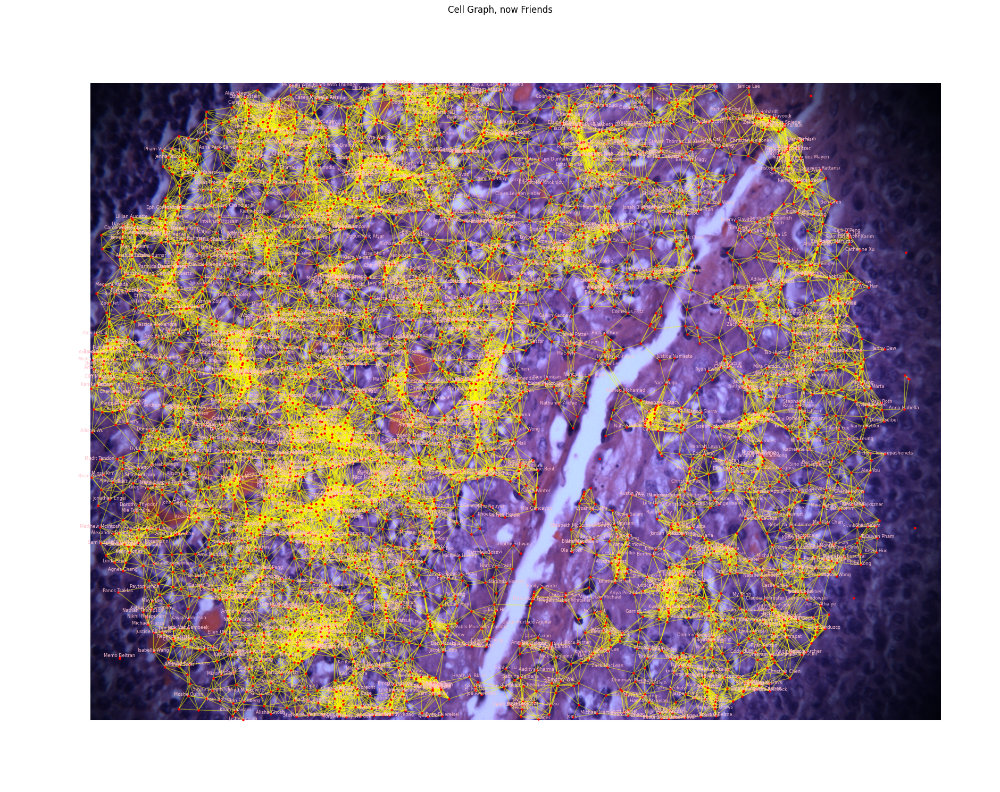

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
from skimage.io import imread

# Load your image (ensure the path and file are correct)
img = imread(filename)

pos = nx.get_node_attributes(cell_graph, 'pos')

fig, ax = plt.subplots(figsize=(24, 24))
ax.imshow(img) 
nx.draw_networkx_nodes(cell_graph, pos, ax=ax, node_size=5, node_color='red', alpha=1.0)
nx.draw_networkx_edges(cell_graph, pos, ax=ax, edge_color='yellow', alpha=0.5)

# Overlay friends
cell_to_friend_mapping = {v: k for k, v in friend_to_cell_mapping.items()}
for node, name in cell_to_friend_mapping.items():
    x, y = pos[node]
    plt.text(x, y+0.02, s=name, horizontalalignment='center', fontsize=6, color='pink')


# Set plot details
ax.set_title('Cell Graph, now Friends')
ax.axis('off')  # Hide axes
plt.show()


# Final cutouts

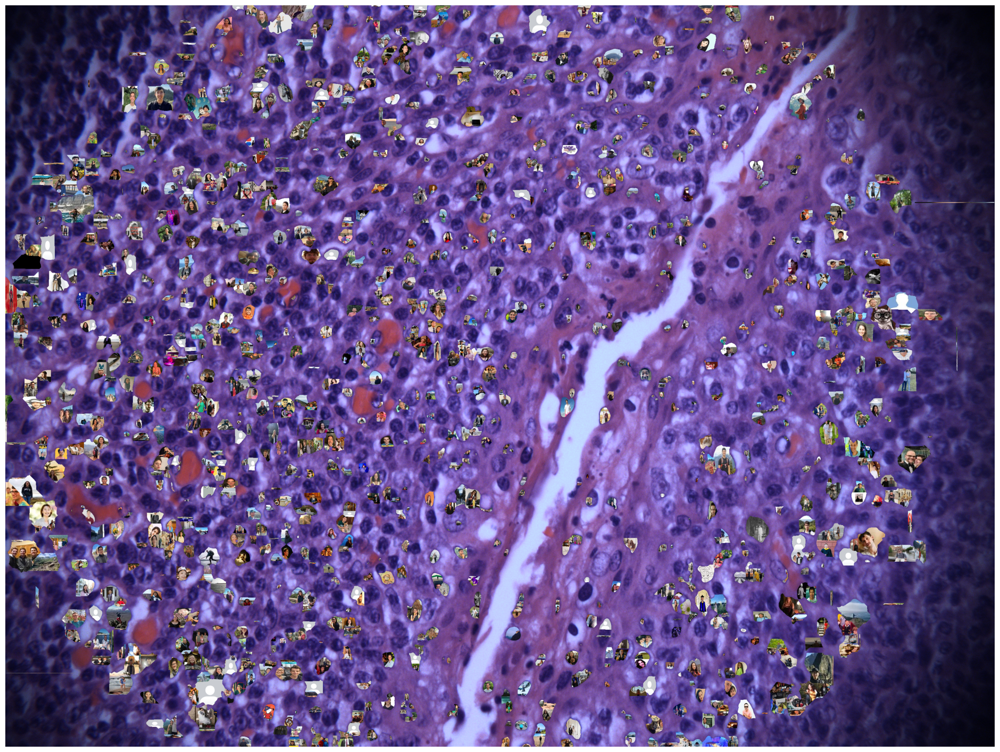

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image, ImageOps
import numpy as np
import os

# Load the base image
img = Image.open(filename).convert('RGBA')    # Replace 'filename' with your actual file path

# Prepare a composite image with the same size as the base image and transparent background
composite = Image.new('RGBA', img.size, (0, 0, 0, 0))  # Fully transparent layer


# Process each segment
for node, data in friends_graph.nodes(data=True):
    cell_label = friend_to_cell_mapping[data['name']]  # Ensure this mapping is correctly provided

    profile_pic_path = os.path.join('friend_pics', f"{data['name'].replace(' ', '_')}.png")
    profile_pic = Image.open(profile_pic_path) if os.path.exists(profile_pic_path) else Image.new('RGB', (50, 50), 'green')
    profile_pic = profile_pic.convert('RGBA')  # Ensure RGBA for transparency handling

    # Create a mask for the current segment
    mask = (new_segmentation == cell_label)
    if np.any(mask):
        # Extract the bounding box of the mask
        masked_area = np.where(mask)
        ymin, ymax = masked_area[0].min(), masked_area[0].max()
        xmin, xmax = masked_area[1].min(), masked_area[1].max()
        
        # Resize profile picture to match the bounding box size
        profile_pic = profile_pic.resize((xmax - xmin + 1, ymax - ymin + 1))
        
        # Create a new mask image that matches the resized profile picture
        mask_resized = mask[ymin:ymax+1, xmin:xmax+1]
        mask_image = Image.fromarray((mask_resized * 255).astype('uint8')).convert('L')
        profile_pic.putalpha(mask_image)  # Apply mask as alpha channel

        # Paste the masked profile picture onto the composite image at the right location
        composite.paste(profile_pic, (xmin, ymin), profile_pic)


# Composite the final image with the base image using alpha compositing
final_image = Image.alpha_composite(img, composite)

# Display the final composited image
fig, ax = plt.subplots(figsize=(24, 24))
ax.imshow(final_image.convert('RGB'))  # Convert back to RGB to display with matplotlib
ax.set_axis_off()
plt.show()

